# Refine scanvi labels

This notebook performs cell type label refinement, starting with the labels predicted in [01_label_prediction_scanvi.ipynb](01_label_prediction_scanvi.ipynb)

The activated CD4 subset is further sublabeled by co-embedding with CITE-seq data in [03_cd4_cite_integration.ipynb](03_cd4_cite_integration.ipynb)

In [1]:
import sys
import os
import hisepy as hp

import numpy as np
import pandas as pd

import anndata as ad
import scanpy as sc
import squidpy as sq

import matplotlib.pyplot as plt
import seaborn as sns

import scvi

import joblib

import math

In [2]:
print('active conda environment: ', os.path.basename(sys.prefix))

active conda environment:  space2


In [3]:
import warnings
warnings.filterwarnings("ignore", category=FutureWarning, message=".*default value of 'ignore' for the `na_action` parameter.*")
warnings.filterwarnings("ignore", category=UserWarning, message=".*No data for colormapping provided via 'c'.*")
warnings.filterwarnings("ignore", category=UserWarning, message=".*ImplicitModificationWarning.*")
warnings.filterwarnings("ignore", category=FutureWarning)
warnings.filterwarnings("ignore", category=UserWarning, module="scanpy")

In [4]:
import matplotlib as mpl
mpl.rcParams['axes.titlesize'] = 20  

## HISE Upload / download info

In [5]:
## Create a list to add all the files to download from HISE
download_files = []

## Create a list to add all the files to upload to HISE
upload_files = []

## Define desitnation ID
destination_tag = 'mouselung_manuscript2025'

## Study space UUID
collab_space_name = hp.get_study_spaces()[1]['name']
study_space_uuid = hp.get_study_spaces()[1]['id']

## Upload title
from datetime import date
title = f'{str(date.today())} mouse lung scanvi labeling files refined[KA]'

print(destination_tag)
print(collab_space_name)

mouselung_manuscript2025
Mouse lung spatial transcriptomics


## Local file info

In [6]:
out_dir = '/home/workspace/spatial_mouse_lung_outputs/cell_labeling/ouputs_mouselung_hurskainen_ref_consolidate_labels_xenseg_HDM'

if not os.path.exists (out_dir):
    os.makedirs(out_dir)

## Download files from HISE

adata object of the xenium samples output after running scanvi


In [7]:
# file_uuid = ["ac52b92b-f4da-4644-aae8-09c9abbbf573"] # adata with scanvi outputs - contains both reference and xenium cells
# download_files.extend(file_uuid)

# # cache files from hise
# adata_filepath = hp.cache_files(file_uuid)[0]

## Or load xenium files locally for now

In [8]:
adata_filepath = os.path.join(out_dir, 'adata_concat_scanvi.h5ad')

### Load adata

In [9]:
# Load xenium and reference adata objects from cache
adata_concat = sc.read_h5ad(adata_filepath)

# update obsm, obs
adata_concat.obsm['X_umap_scanvi_refalign'] = adata_concat.obsm['X_umap']
adata_concat.obs['label_scanvi'] = adata_concat.obs['C_scANVI']
adata_concat.obs['label_scanvi'] = adata_concat.obs['label_scanvi'].astype('category')

# take Xenium only (remove reference cells)
adata = adata_concat[adata_concat.obs['sample']!='hurskainen_ref', :]

## Visualize predicted labels

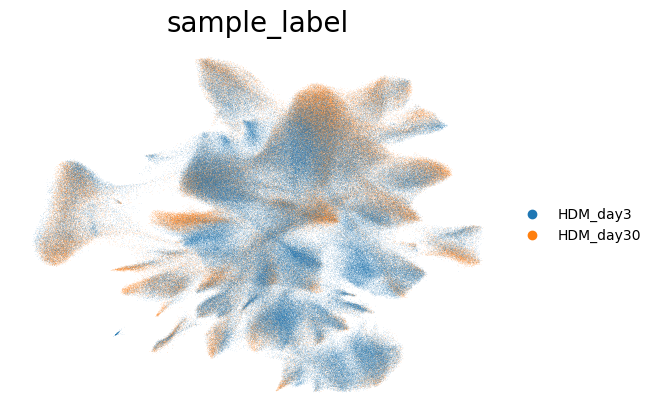

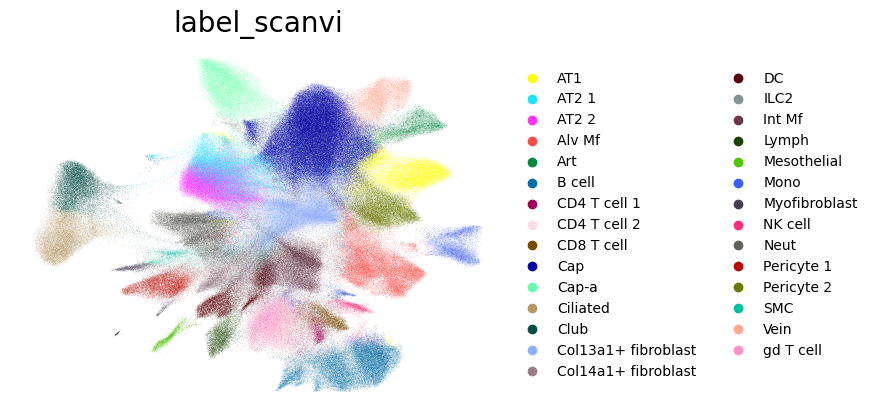

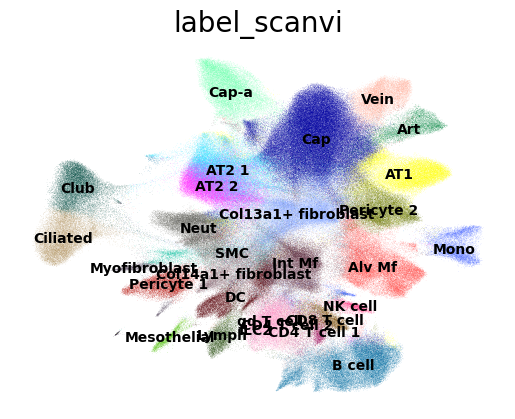

In [11]:
# scanvi dimensions
sc.pl.embedding(adata, basis='X_umap', color='sample_label', frameon=False)
sc.pl.embedding(adata, basis='X_umap', color='label_scanvi', frameon=False)
sc.pl.embedding(adata, basis='X_umap', color='label_scanvi', frameon=False, legend_loc='on data')

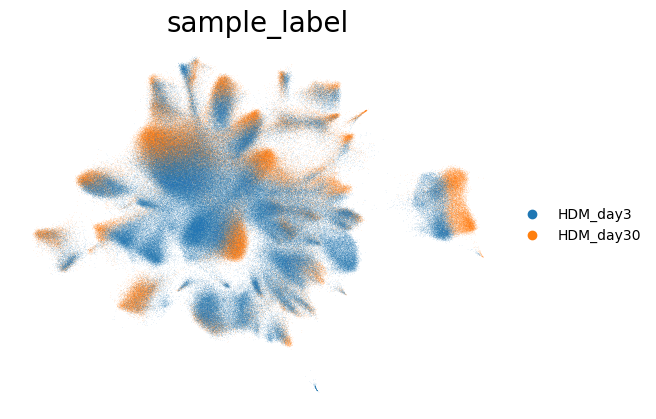

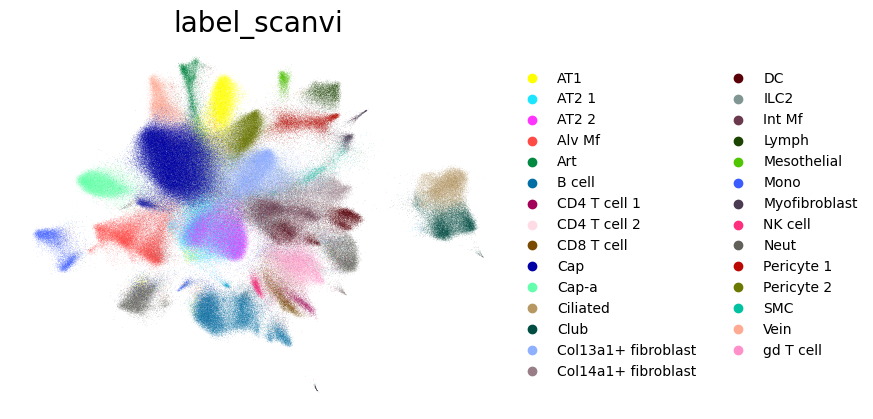

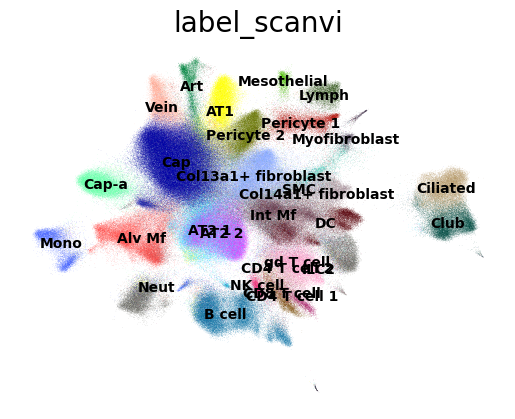

In [14]:
# scvi dimensions
sc.pl.embedding(adata, basis='X_umap_scvi_refalign', color='sample_label', frameon=False)
sc.pl.embedding(adata, basis='X_umap_scvi_refalign', color='label_scanvi', frameon=False)
sc.pl.embedding(adata, basis='X_umap_scvi_refalign', color='label_scanvi', frameon=False, legend_loc='on data')

## Update labels by subclustering and manually labeling

In [21]:
# major markers
major_markers_short = [  
    "Cd79a", # B cell
    "Cd3e", "Cd8a", "Cd4", # T cell
    "Cxcr5",
    "Foxp3",
    "Nkg7",
    "Apoe", #Mac
    "Cd34",  # BEC
    "Prox1", "Lyve1", # LEC
    "Epcam", # epithelial

]

tcell_markers = ['Cd79a', # b cell
                 'Nkg7', # NK
                 'Prdm1',
                 'Cd3e', 'Cd4', 'Cd8a', # t cell 
                 'Tcrg-C1', 'Tcrg-C2', 'Tcrg-C4', # gdTcell
                 'Rora', # ilc2
                 'Cd44', # activation
                'Foxp3', # Treg
                 'Gata3','Il1rl1', 'Il4', 'Il13', 'Il5', 'Ccr4',# Th2
                 'Tbx21', 'Ifng', 'Cxcr3',  # Th1
                 'Rorc','Il23a','Il17a','Ccr6',  # Th17
                 'Tcf7', # Tfh
                 'Cxcr6', 'Cxcr5','Cxcr4','Stat6',
                ]
tcell_markers_short = [
                       'Cd44', # activation
                       'Tcf7', 'Slamf6',
                       'Cxcr6',
                       'Gata3', 'Il1rl1',
                       'Foxp3', 'Rorc']
contaminating = ['Tcf21', 'Pdpn','Itgax', 'Slc34a2']
bcell_markers = ['Cd79a', 
                 'Prdm1' # plasmablasts
                ]
dc_markers = ['Xcr1', 'Cd8a','Clec9a', # cDC1
              'Clec1b', #cDC2
              'Ccr7', 'Irf4', 'Notch2','H2-Ab1','Ccr6','Ly6c2' # others to try
             #'Sirpa', 'CD11b' # cDC2
             ]


In [19]:
def subcluster_celltype(adata, label_col, labels, res=1, seed=1234):
    """
    Subcluster a specific cell type or set of labels in an AnnData object using a precomputed embedding (e.g., scVI).

    Parameters
    ----------
    adata : anndata.AnnData
        The full AnnData object containing expression data, metadata, and embeddings.

    label_col : 
        The name of the column in `adata.obs` that contains labels used for subsetting (e.g., "celltype", "cluster").

    labels : list
        A list of values to use for subsetting. These values will be matched against entries in `adata.obs[label_col]`.

    res : float, optional (default=1)
        Resolution parameter for Leiden clustering.

    seed : int, optional (default=1234)
        Random seed used for reproducibility.

    Returns
    -------
    adata_sub : anndata.AnnData
        The subset AnnData object containing only the specified labels, with new UMAP, Leiden clustering,
        and marker gene results stored.
    """
    np.random.seed(seed)
    
    # subcluster
    print(labels)
    print('res', res)
    adata_sub = adata[adata.obs[label_col].isin(labels), :]

    print('neighbors')
    sc.pp.neighbors(adata_sub, use_rep='X_scVI_refalign', key_added='neighbors_scvi_subset')
    print('leiden')
    sc.tl.leiden(adata_sub, neighbors_key='neighbors_scvi_subset', resolution=res, key_added='leiden_subset', n_iterations=2)
    print('umap')
    sc.tl.umap(adata_sub, neighbors_key='neighbors_scvi_subset')

    # identify markers of each subcluster 
    print('get cluster markers')
    sc.tl.rank_genes_groups(
        adata_sub,
        groupby='leiden_subset',  method='wilcoxon')
    
    # update the name of the subset umap dims
    adata_sub.obsm['X_umap_subset'] = adata_sub.obsm['X_umap']
    del adata_sub.obsm['X_umap']
    
    return adata_sub

In [20]:
adata_CD4 = subcluster_celltype(adata, label_col= 'label_scanvi', labels = ['CD4 T cell 1', 'CD4 T cell 2'], res=1)
adata_Bcell = subcluster_celltype(adata, label_col= 'label_scanvi', labels = ['B cell'], res=0.7)
adata_DC = subcluster_celltype(adata, label_col= 'label_scanvi', labels = ['DC'], res=0.7)
adata_CD8 = subcluster_celltype(adata, label_col= 'label_scanvi', labels = ['CD8 T cell'], res=0.7)

adata_CD4.write_h5ad(os.path.join(out_dir, 'adata_CD4.h5ad'), compression='gzip')
adata_Bcell.write_h5ad(os.path.join(out_dir, 'adata_Bcell.h5ad'), compression='gzip')
adata_DC.write_h5ad(os.path.join(out_dir, 'adata_DC.h5ad'), compression='gzip')
adata_CD8.write_h5ad(os.path.join(out_dir, 'adata_CD8.h5ad'), compression='gzip')

adata_tcell_innate = subcluster_celltype(adata, label_col= 'label_scanvi', 
                                         labels = ['CD4 T cell 1', 'CD4 T cell 2',
                                                  'B cell','CD8 T cell','gd T cell', 'ILC2', 'NK cell'], 
                                         res=1)
adata_tcell_innate.write_h5ad(os.path.join(out_dir, 'adata_tcell_innate.h5ad'), compression='gzip')

['CD4 T cell 1', 'CD4 T cell 2']
res 1
neighbors
leiden
umap
get cluster markers
['B cell']
res 1
neighbors
leiden
umap
get cluster markers
['DC']
res 1
neighbors
leiden
umap
get cluster markers
['CD8 T cell']
res 0.7
neighbors
leiden
umap
get cluster markers
['CD4 T cell 1', 'CD4 T cell 2', 'B cell', 'CD8 T cell', 'gd T cell', 'ILC2', 'NK cell']
res 1
neighbors
leiden
umap
get cluster markers


### If subclustering already run and saved locally, load those adata objects

In [37]:
# adata_CD4 = sc.read_h5ad(os.path.join(out_dir, 'adata_CD4.h5ad'))
# adata_Bcell = sc.read_h5ad(os.path.join(out_dir, 'adata_Bcell.h5ad'))
# adata_DC = sc.read_h5ad(os.path.join(out_dir, 'adata_DC.h5ad'))

### Label CD4 T cell subclusters
- CD4 naive and CD4 act based on CD44

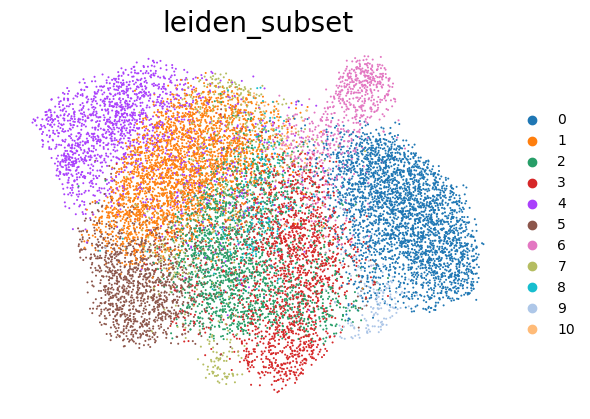

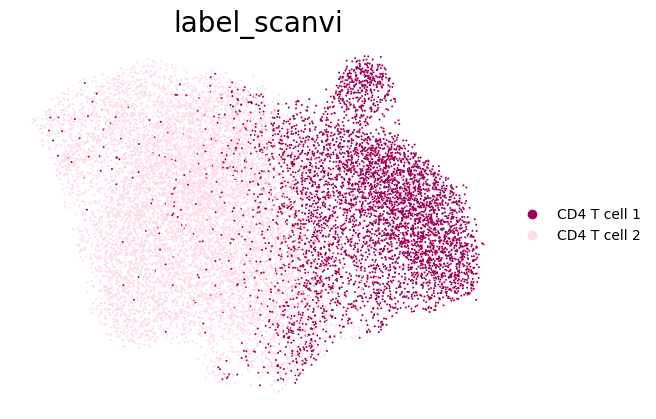

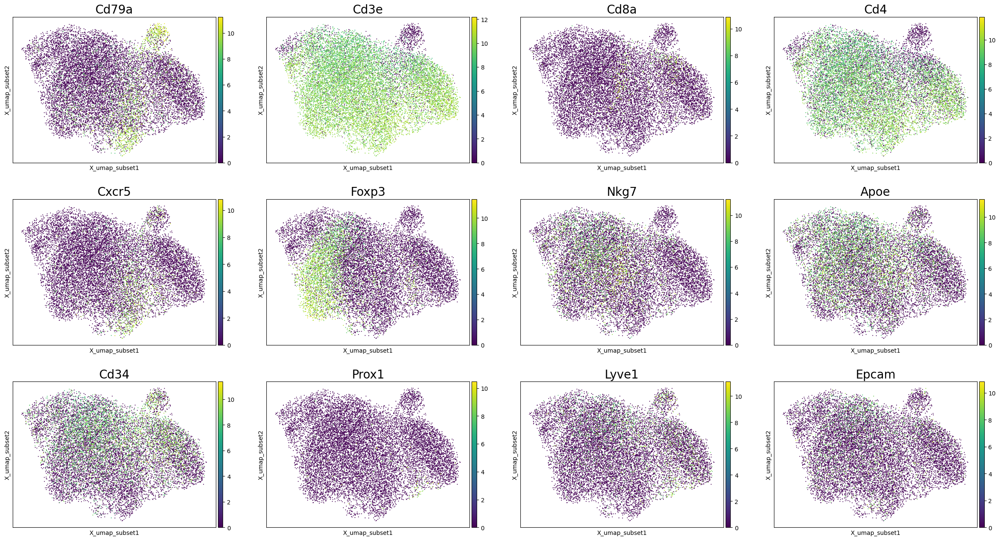

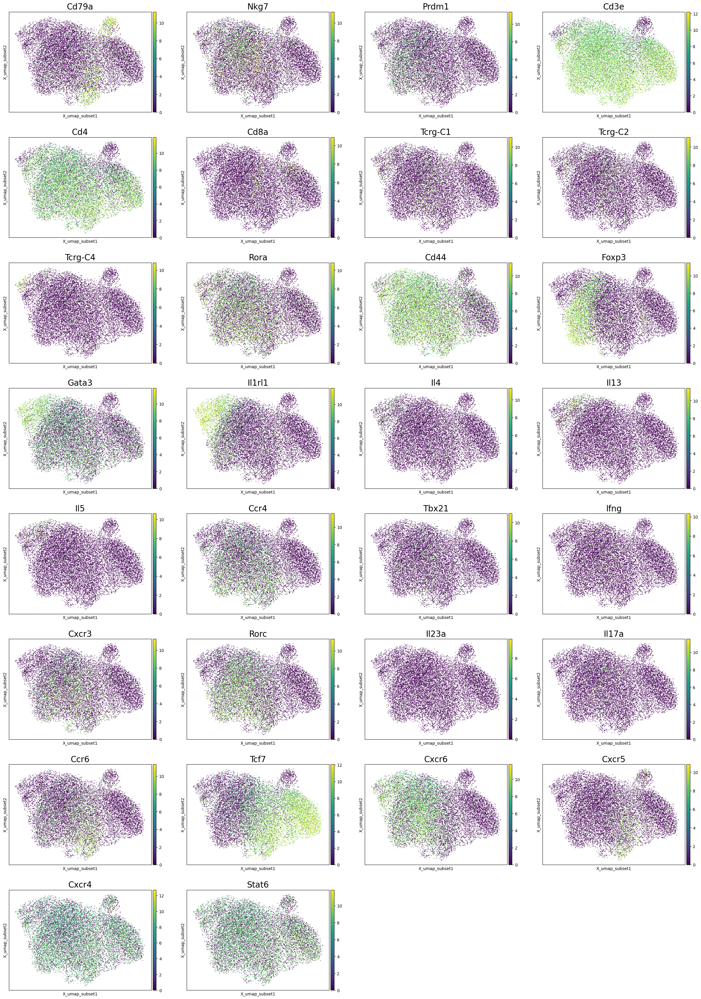

In [22]:
sc.pl.embedding(adata_CD4, basis = 'X_umap_subset', color= ['leiden_subset'], frameon=False)
sc.pl.embedding(adata_CD4, basis = 'X_umap_subset', color= ['label_scanvi'], frameon=False)
sc.pl.embedding(adata_CD4, basis = 'X_umap_subset', color= major_markers_short)
sc.pl.embedding(adata_CD4, basis = 'X_umap_subset', color= tcell_markers, ncols=4)

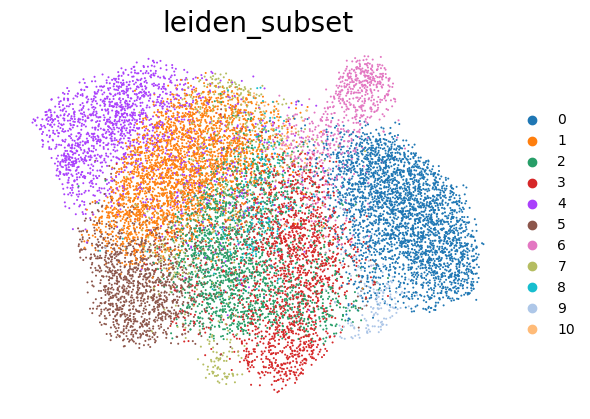

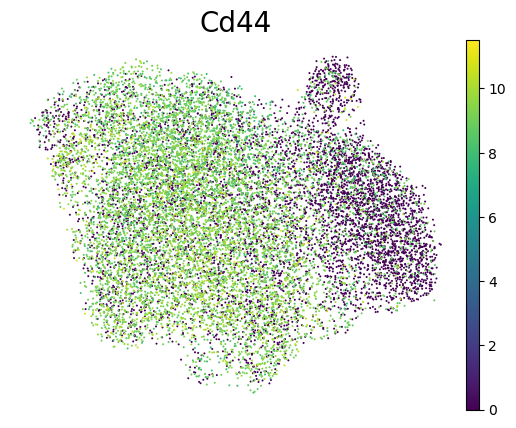

In [26]:
sc.pl.embedding(adata_CD4, basis = 'X_umap_subset', color= ['leiden_subset'], frameon=False)
sc.pl.embedding(adata_CD4, basis = 'X_umap_subset', color= 'Cd44', frameon=False)

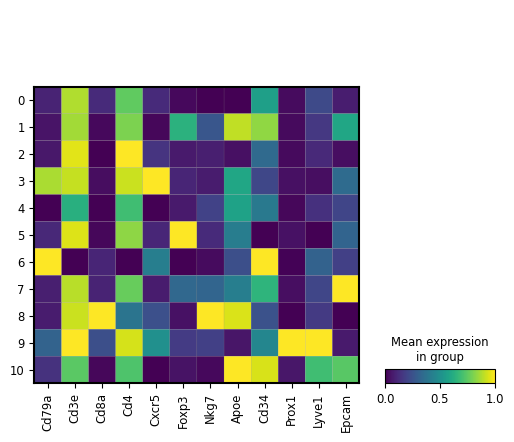

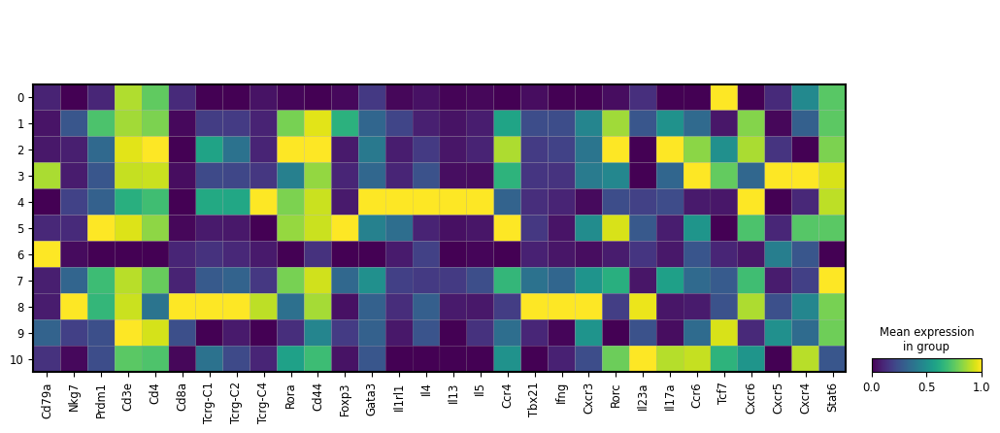

In [27]:
sc.pl.matrixplot(adata_CD4, var_names=major_markers_short, groupby='leiden_subset', standard_scale='var')
sc.pl.matrixplot(adata_CD4, var_names=tcell_markers, groupby='leiden_subset', standard_scale='var')

In [28]:
# define cluster to label map 
leiden_mapping = {
    "0": "CD4 naive",
    "1": "CD4 act",
    "2": "CD4 act",
    "3": "CD4 act",
    "4": "CD4 act",
    "5": "CD4 act",
    "6": "CD4 naive", 
    "7": "CD4 act",
    "8": "CD4 act",
    "9": "CD4 act",
    "10": "CD4 act",
}

# Apply mapping to create a new column
adata_CD4.obs['leiden_subset_label'] = adata_CD4.obs['leiden_subset'].map(leiden_mapping)



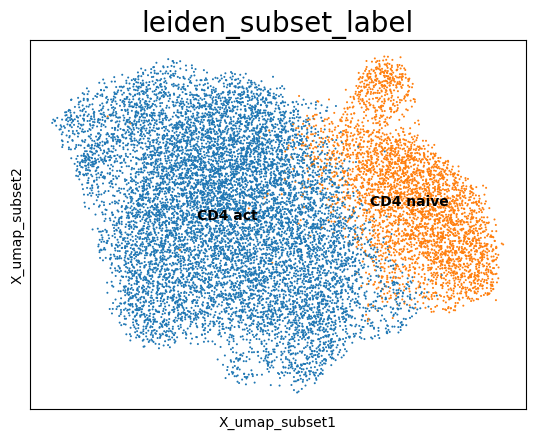

In [29]:
sc.pl.embedding(adata_CD4, basis = 'X_umap_subset', color= ['leiden_subset_label'], legend_loc='on data')

### Label B cell subclusters
- Plasmablasts based on Prdm1
- Assign cluster without B cell marker expression as 'unknown'

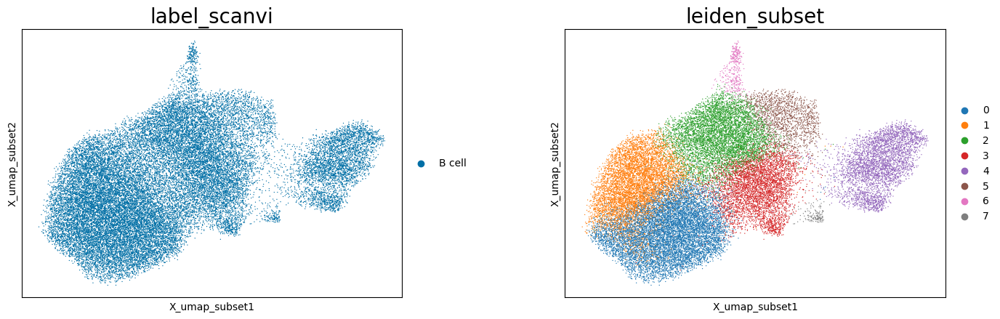

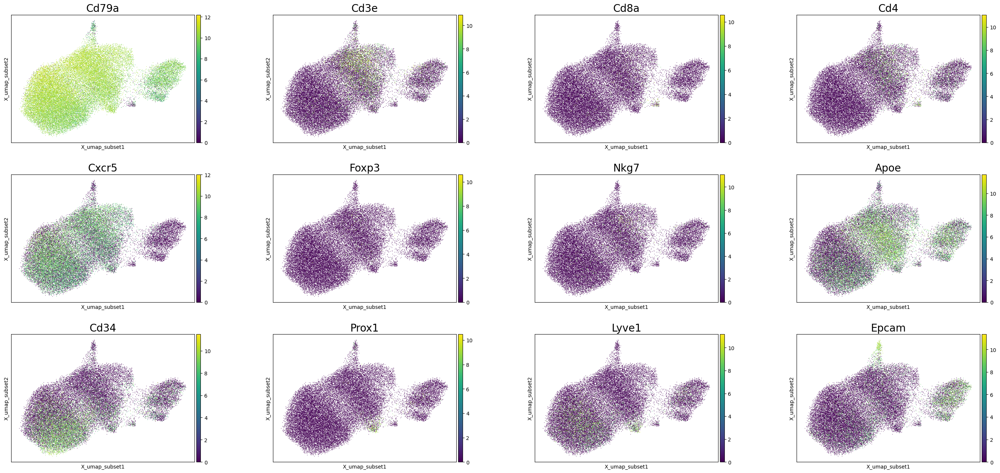

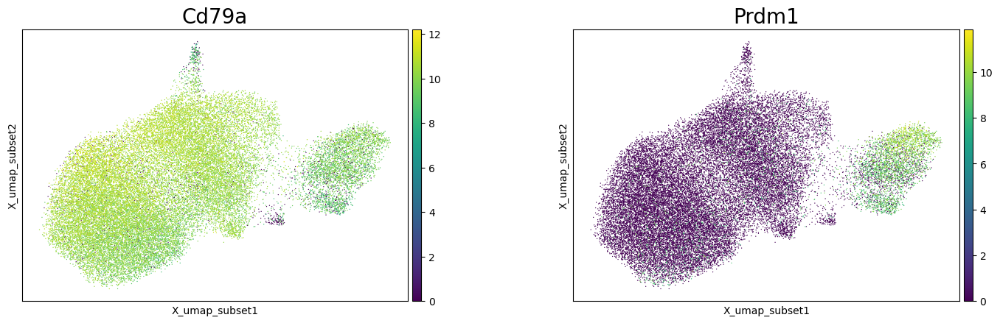

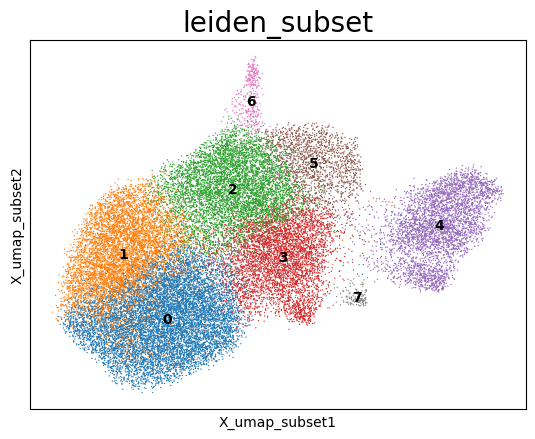

In [44]:
sc.pl.embedding(adata_Bcell, basis = 'X_umap_subset', color= ['label_scanvi', 'leiden_subset'], wspace=0.3)
sc.pl.embedding(adata_Bcell, basis = 'X_umap_subset', color= major_markers_short, wspace=0.3)
sc.pl.embedding(adata_Bcell, basis = 'X_umap_subset', color= bcell_markers, wspace=0.3)
sc.pl.embedding(adata_Bcell, basis = 'X_umap_subset', color= 'leiden_subset', legend_loc='on data')

In [45]:
# define cluster to label map 
leiden_mapping = {
    "4": "Plasmablast",
    "7": "unknown"
}

# Apply mapping to create a new column
adata_Bcell.obs['leiden_subset_label'] = adata_Bcell.obs['leiden_subset'].map(leiden_mapping).fillna(adata_Bcell.obs['label_scanvi'])



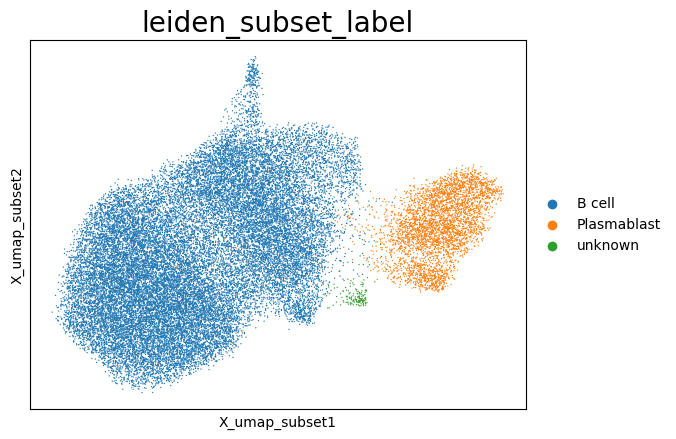

In [46]:
sc.pl.embedding(adata_Bcell, basis = 'X_umap_subset', color= ['leiden_subset_label'])

### Label DC subclusters
- cDC1 based on high Xcr1 expression
- Distinguish Ccr7+ and Ccr7- cDC2

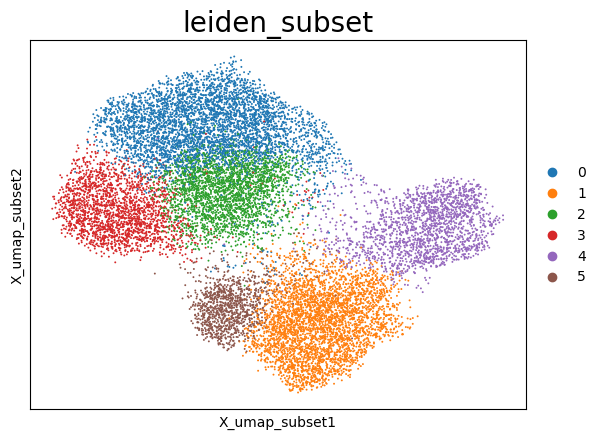

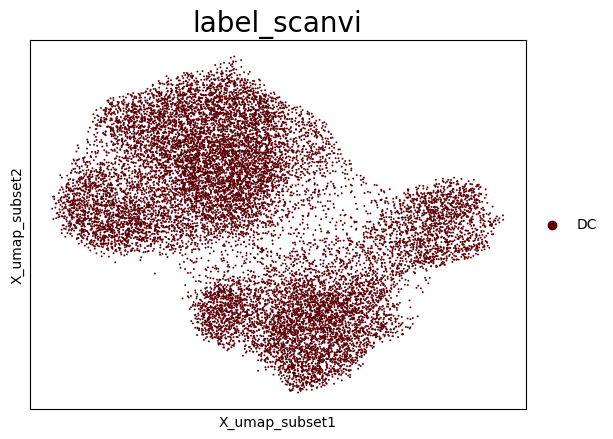

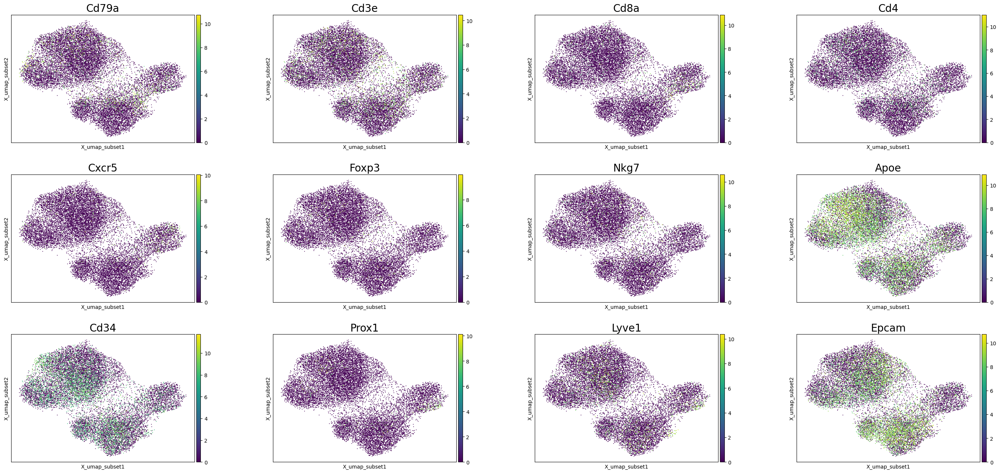

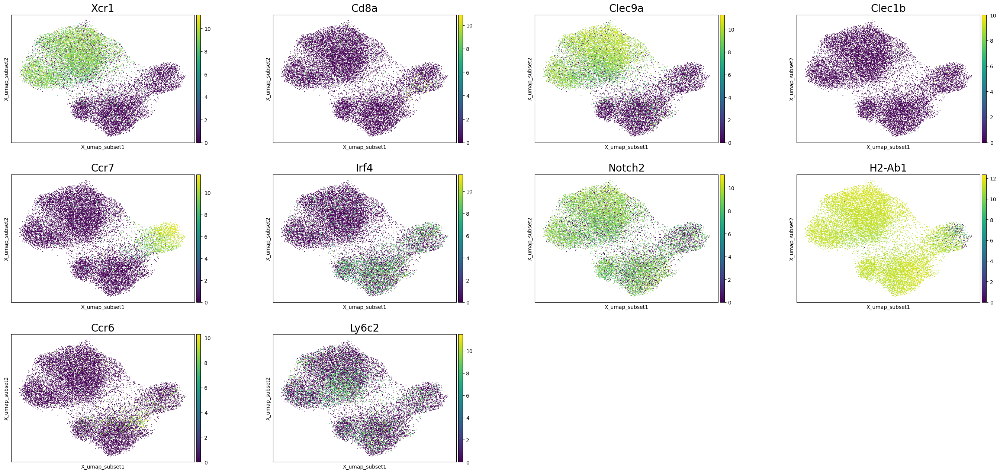

In [47]:
sc.pl.embedding(adata_DC, basis = 'X_umap_subset', color= ['leiden_subset'])
sc.pl.embedding(adata_DC, basis = 'X_umap_subset', color= ['label_scanvi'])
sc.pl.embedding(adata_DC, basis = 'X_umap_subset', color= major_markers_short, wspace=0.3)
sc.pl.embedding(adata_DC, basis = 'X_umap_subset', color= dc_markers, wspace=0.3)

In [48]:
# define cluster to label map 
leiden_mapping = {
    "0": "cDC1",
    "1": "Ccr7- cDC2",
    "2": "cDC1",
    "3": "cDC1",
    "4": "Ccr7+ cDC2",
    "5": "Ccr7- cDC2",
    "6": "cDC1",
    "7": "cDC1",
    "8": "cDC1"

}

# Apply mapping to create a new column
adata_DC.obs['leiden_subset_label'] = adata_DC.obs['leiden_subset'].map(leiden_mapping).fillna(adata_DC.obs['label_scanvi'])



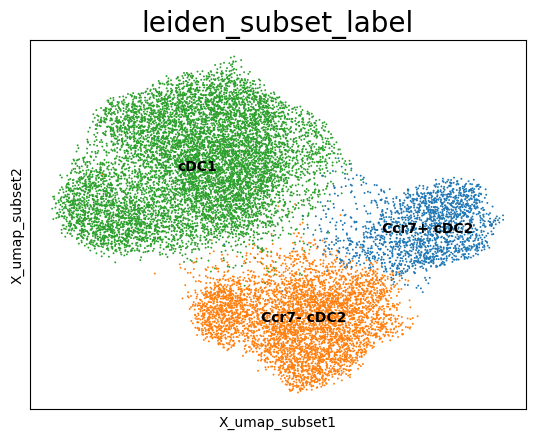

In [49]:
sc.pl.embedding(adata_DC, basis = 'X_umap_subset', color= 'leiden_subset_label', legend_loc='on data')

### Label CD8 subclusters
- Distinguish naive and activated by CD44

In [50]:
cd8_markers = ['Cd44', 'Tbx21', 'Ifng','Cd69', 'Tcf7', 'Sell']

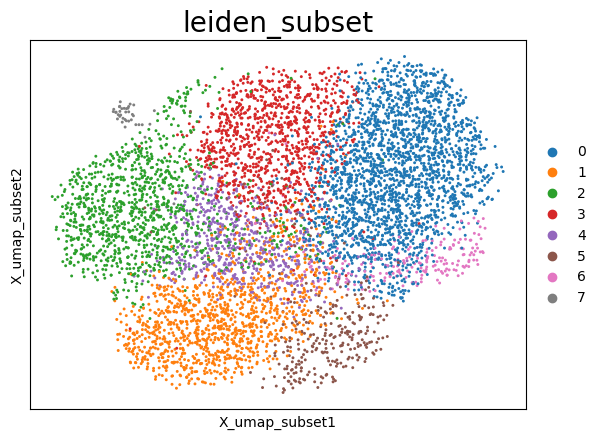

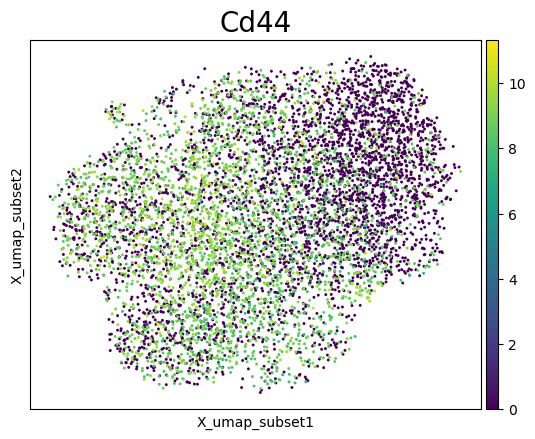

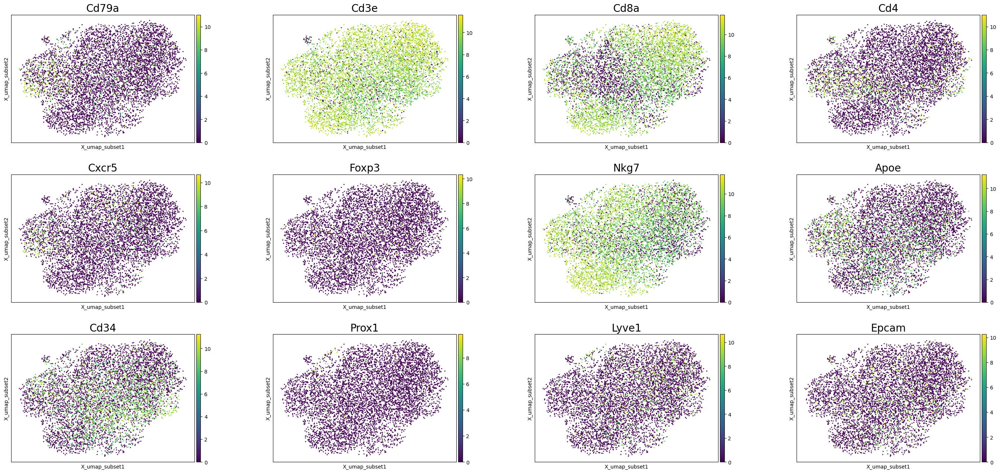

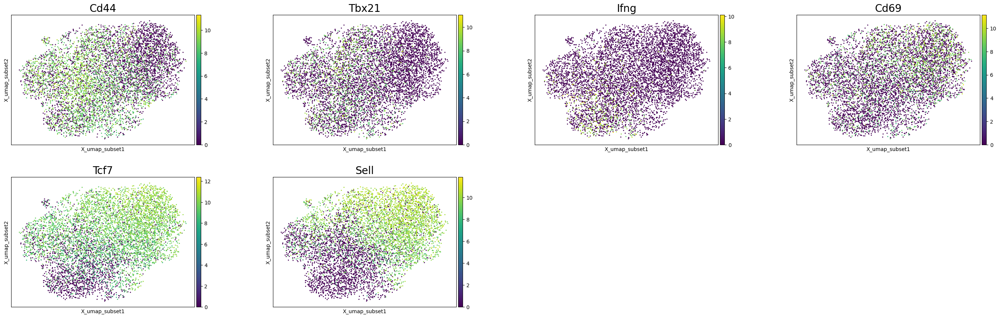

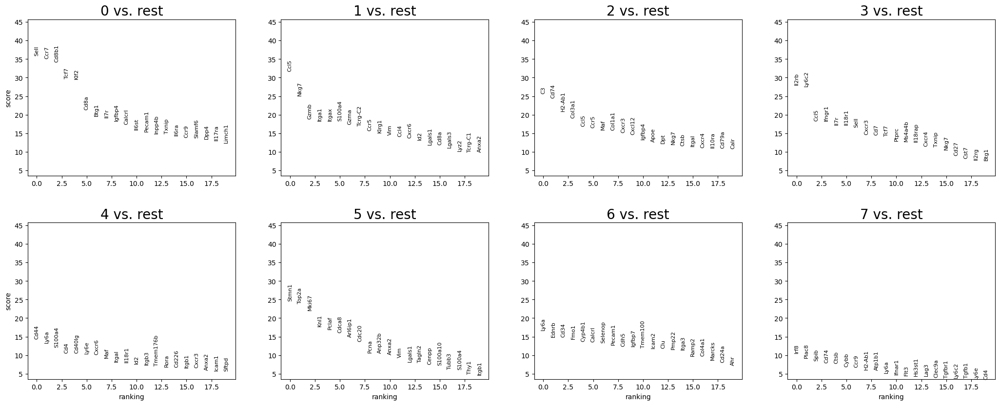

In [51]:
sc.pl.embedding(adata_CD8, basis = 'X_umap_subset', color= ['leiden_subset'])
sc.pl.embedding(adata_CD8, basis = 'X_umap_subset', color= 'Cd44')
sc.pl.embedding(adata_CD8, basis = 'X_umap_subset', color= major_markers_short, wspace=0.3)
sc.pl.embedding(adata_CD8, basis = 'X_umap_subset', color= cd8_markers, wspace=0.3)
sc.pl.rank_genes_groups(adata_CD8)

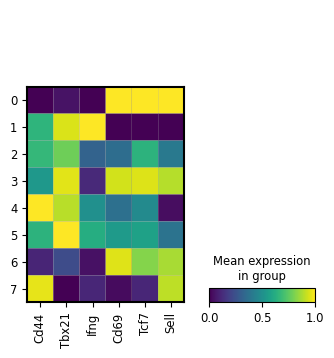

In [52]:
# all
sc.pl.matrixplot(adata_CD8, var_names=cd8_markers, groupby='leiden_subset', standard_scale='var')

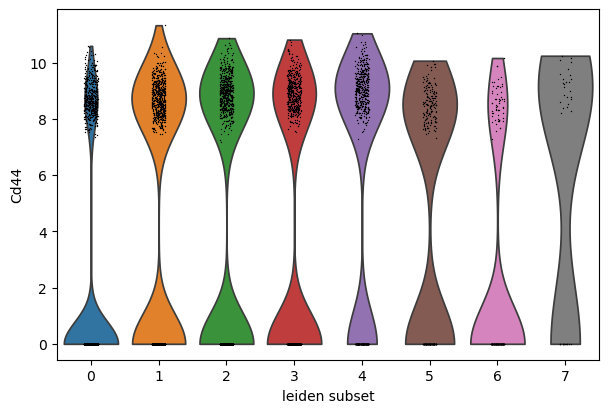

In [53]:
sc.pl.violin(adata_CD8, keys='Cd44', groupby='leiden_subset')

In [54]:
# define cluster to label map 
leiden_mapping = {
    "0": "CD8 naive",
    "1": "CD8 act",
    "2": "CD8 act",
    "3": "CD8 act",
    "4": "CD8 act",
    "5": "CD8 act",
    "6": "CD8 act",
    "7": "CD8 act",
}

# Apply mapping to create a new column
adata_CD8.obs['leiden_subset_label'] = adata_CD8.obs['leiden_subset'].map(leiden_mapping).fillna(adata_CD8.obs['label_scanvi'])



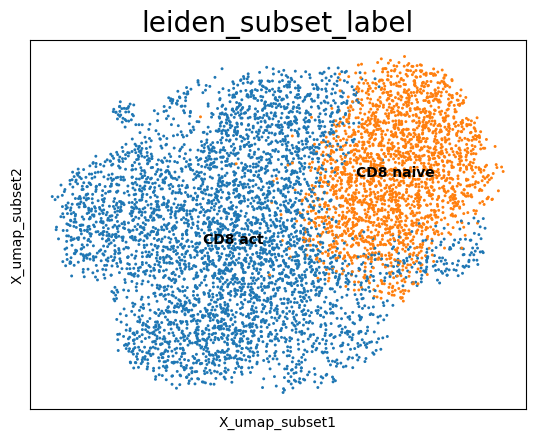

In [55]:
sc.pl.embedding(adata_CD8, basis = 'X_umap_subset', color= ['leiden_subset_label'], legend_loc='on data')

## Resave all subclustered objects

In [56]:
adata_CD4.write_h5ad(os.path.join(out_dir, 'adata_CD4.h5ad'), compression='gzip')
adata_Bcell.write_h5ad(os.path.join(out_dir, 'adata_Bcell.h5ad'), compression='gzip')
adata_DC.write_h5ad(os.path.join(out_dir, 'adata_DC.h5ad'), compression='gzip')
adata_CD8.write_h5ad(os.path.join(out_dir, 'adata_CD8.h5ad'), compression='gzip')

## Put subcluster labels back on main adata object 

In [1]:
def update_adata_labels(adata_main, adata_sub_list, subset_label_col, main_label_col,new_main_label_col):
    """
    Updates a copy of adata_main.obs by setting values in new_main_label_col based on matching indices in adata_sub_list.
    If an index is not found in any adata_sub, it takes its value from main_label_col.


    Parameters
    ----------
    adata_main : AnnData
        The main AnnData object whose `.obs` will be updated (without modifying the original).

    adata_sub_list : list of AnnData
        A list of subset AnnData objects that contain updated labels for subsets of cells.

    subset_label_col : str
        Column in `adata_sub.obs` containing the labels to transfer to the main object.

    main_label_col : str
        Column in `adata_main.obs` to use as a fallback label for cells not found in any `adata_sub`.

    new_main_label_col : str
        The name of the new column to create in `adata_main.obs` for the updated labels.

    Returns
    -------
    AnnData
        A copy of `adata_main` with a new column `new_main_label_col` in `.obs`, updated with labels 
        from the subsets where available, and fallback labels elsewhere.
    """

    # Create a copy of adata_main to avoid modifying the original
    adata_main = adata_main.copy()

    # Initialize the new column in the copy by copying from main_label_col
    adata_main.obs[new_main_label_col] = adata_main.obs[main_label_col].astype(str)

    # Iterate through each sub-adata object
    for adata_sub in adata_sub_list:
        # Get overlapping indices
        matching_indices = adata_main.obs.index.intersection(adata_sub.obs.index)
        
        # Update the new column in the copied adata_main with values from subset_label_col in adata_sub
        adata_main.obs.loc[matching_indices, new_main_label_col] = adata_sub.obs.loc[matching_indices, subset_label_col]

    adata_main.obs[new_main_label_col] = adata_main.obs[new_main_label_col].astype('category')

    return adata_main


In [58]:
# add subcluster labels
main_label_col = 'label_scanvi'
subset_label_col = 'leiden_subset_label'
new_main_label_col = 'label_scanvi_refine'

adata_sub_list = [adata_CD4, adata_Bcell, adata_DC, adata_CD8]
adata = update_adata_labels(adata, adata_sub_list, subset_label_col, main_label_col, new_main_label_col)

# combine cell types where necessary
adata.obs['label_scanvi_refine'] = adata.obs['label_scanvi_refine'].astype(str)
adata.obs.loc[adata.obs['label_scanvi'].isin(['AT2 1', 'AT2 2']), 'label_scanvi_refine'] = 'AT2'
adata.obs['label_scanvi_refine'] = adata.obs['label_scanvi_refine'].astype('category')


## Final label cleaning
- Remove cells that are outliers in scvi umap
- Remove small number of cells labeled as 'unknown' after subclustering 

In [ ]:
# Identify and remove outlier clusters 

In [74]:
# run leiden on scvi dimensions of full adata object with reference cells included 
sc.tl.leiden(adata_concat, resolution = 0.5, key_added='leiden_scvi_refalign', neighbors_key = 'neighbors_scvi_refalign', n_iterations=2)

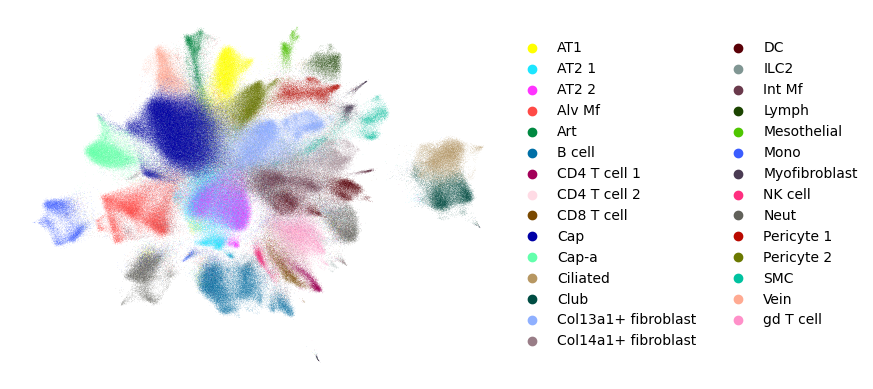

In [92]:
sc.pl.embedding(adata_concat, basis = 'X_umap_scvi_refalign', color='label_scanvi', title = '', frameon=False)

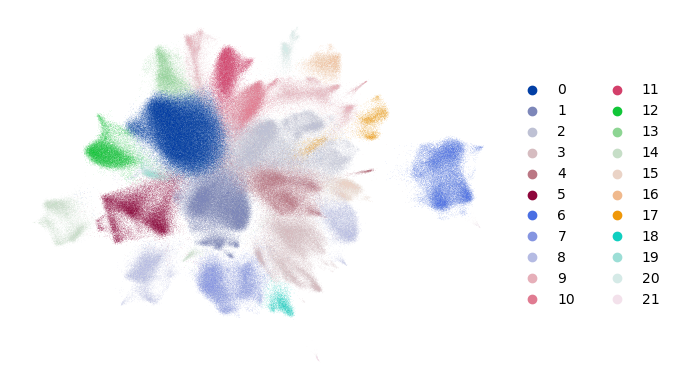

In [79]:
sc.pl.embedding(adata_concat, basis = 'X_umap_scvi_refalign', color='leiden_scvi_refalign', title = '', frameon=False)

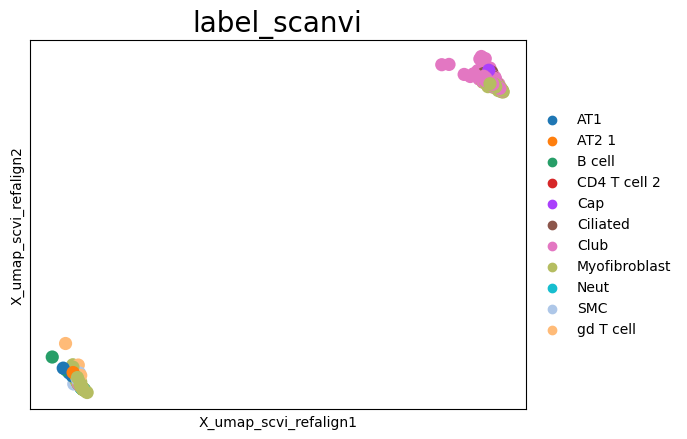

In [89]:
adata_outlier = adata_concat[adata_concat.obs['leiden_scvi_refalign'].isin(['21']), :]
sc.pl.embedding(adata_outlier, basis = 'X_umap_scvi_refalign', color = ['label_scanvi'])
outlier_cells = adata_outlier.obs.index.tolist()

In [93]:
print(adata.shape)
print(f"removing {len(outlier_cells)} outlier cells")
adata = adata[~adata.obs.index.isin(outlier_cells), :]
print(adata.shape)

(593726, 480)
removing 332 outlier cells
(593394, 480)


In [94]:
# Remove unknown label cells
print(f"Removing {sum(adata.obs['label_scanvi_refine'] == 'unknown')} unknown label cells")
adata = adata[adata.obs['label_scanvi_refine'] != 'unknown', :]
print(adata.shape)

Removing 157 unknown label cells
(593237, 480)


## Save labeled adata object

In [95]:
out_dir

'/home/workspace/spatial_mouse_lung_outputs/cell_labeling/ouputs_mouselung_hurskainen_ref_consolidate_labels_xenseg_HDM'

In [96]:
adata.write_h5ad(os.path.join(out_dir, 'adata_labeled.h5ad'), compression='gzip')
# adata = sc.read_h5ad(os.path.join(out_dir, 'adata_labeled.h5ad'))

## Export activated CD4 data for downstream CITE integration

In [97]:
def export_adata_info(adata, output_path):
    """
    Export key components of an AnnData object to CSV files in a specified directory.

    Parameters
    ----------
    adata : anndata.AnnData
        The AnnData object containing the data to export. Assumes a raw count matrix is stored in `adata.layers['counts']`.

    output_path : str
        Path to the directory where the output CSV files will be saved. The directory will be created if it does not exist.

    Returns
    -------
    None
        This function writes files to disk but does not return any value.
    """
    # make save dir
    if not os.path.exists (output_path):
        os.makedirs(output_path)
    
    # Export raw counts 
    raw_counts = adata.layers['counts']
    counts_df = pd.DataFrame.sparse.from_spmatrix(raw_counts, index=adata.obs_names, columns=adata.var_names)
    counts_df.to_csv(os.path.join(output_path, "counts.csv"))

    # cell metadata
    adata.obs.to_csv(os.path.join(output_path,"cell_metadata.csv"))

In [98]:
# activated cd4s
adata_cd4 = adata[adata.obs['label_scanvi_refine']=='CD4 act', :]
adata_cd4.shape

(10486, 480)

In [99]:
output_path = os.path.join(out_dir, 'adata_outs', 'adata_cd4')
export_adata_info(adata_cd4, output_path)

## Label visualization

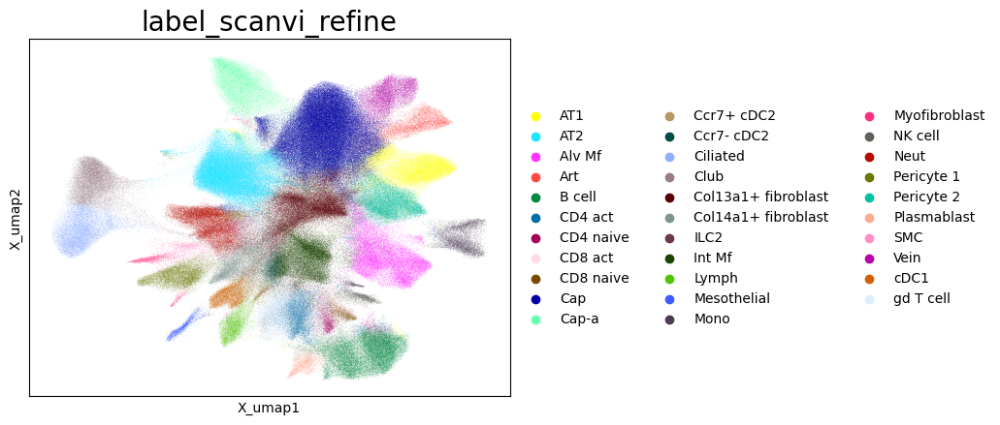

In [100]:
# scanvi umap 
sc.pl.embedding(adata, basis = 'X_umap', color= ['label_scanvi_refine'])

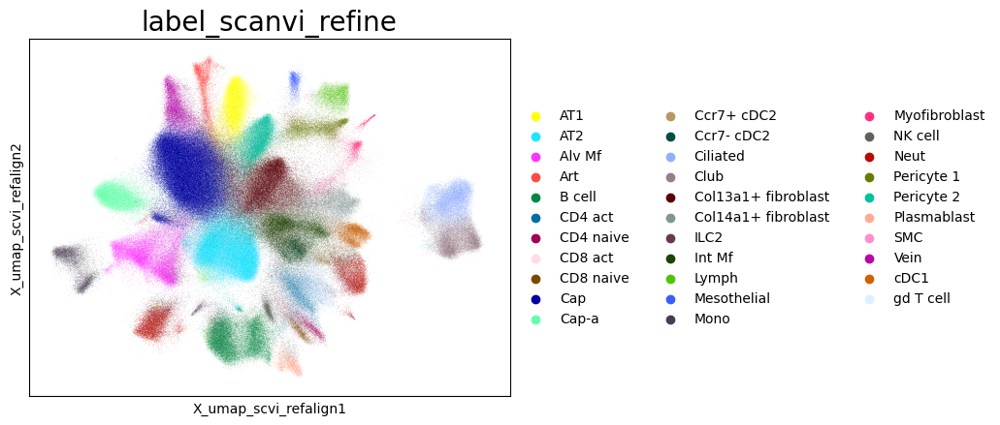

In [101]:
# scvi umap
sc.pl.embedding(adata, basis = 'X_umap_scvi_refalign', color= ['label_scanvi_refine'])

In [102]:
sc.tl.rank_genes_groups(
    adata,
    groupby='label_scanvi_refine',  method='wilcoxon'
)

/home/workspace/environment/space2/lib/python3.12/site-packages/scanpy/tools/_rank_genes_groups.py:396: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  self.stats[group_name, 'names'] = self.var_names[global_indices]
/home/workspace/environment/space2/lib/python3.12/site-packages/scanpy/tools/_rank_genes_groups.py:398: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  self.stats[group_name, 'scores'] = scores[global_indices]
/home/workspace/environment/space2/lib/python3.12/site-packages/scanpy/tools/_rank_genes_groups.py:401: Perform

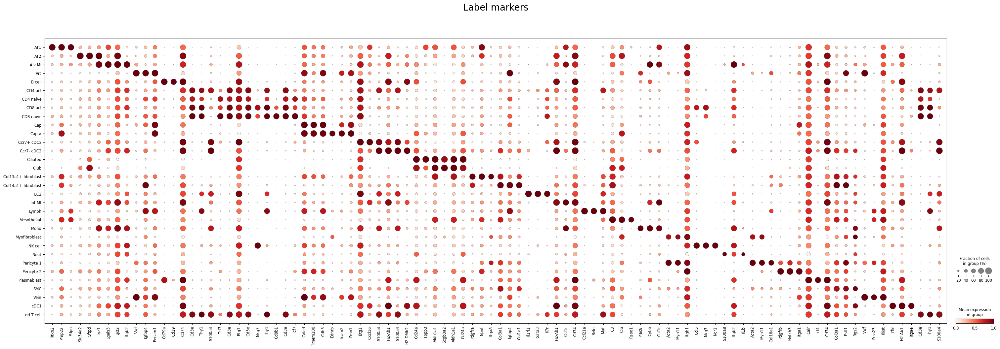

In [103]:
# Extract top 5 marker genes for each cell type
top_markers = pd.DataFrame(adata.uns['rank_genes_groups']['names']).head(3)

# Flatten the DataFrame into a list, preserving order: top 5 genes for each group sequentially
ordered_genes = top_markers.T.values.flatten().tolist()

# Plot dotplot for adata_concat_ref
sc.pl.dotplot(
    adata,
    var_names=ordered_genes,  # Use the ordered list of genes
    groupby='label_scanvi_refine',
    standard_scale='var',  # Optional: Standardize dot sizes per gene
    dendrogram=False,       # Keep the order of groups as in `groupby`
    title= 'Label markers'
)

In [105]:
print('active conda environment: ', os.path.basename(sys.prefix))


active conda environment:  space2
